# Notes

# Load Modules

In [1]:
import os

import numpy as np
import pandas as pd
from more_itertools import flatten

In [2]:
from scipy.spatial import distance

In [3]:
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
mpl.rcParams['font.sans-serif'] = 'Arial'
import seaborn as sns

%matplotlib inline

In [4]:
from scipy.linalg import cholesky, eigh, svd

In [5]:
# Core scverse libraries
import scanpy as sc
import anndata as ad

/sc/arion/work/wangw32/conda-env/envs/py312/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/sc/arion/work/wangw32/conda-env/envs/py312/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/sc/arion/work/wangw32/conda-env/envs/py312/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/sc/arion/work/wangw32/conda-env/envs/py312/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/sc/arion/work/wangw32/conda-env/envs/py312/lib/python3.12/site-packag

# Download Data

In [ ]:
%%bash

wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/counts.h5ad raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/cell_labels.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse1sample1.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse1sample2.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse1sample3.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse1sample4.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse1sample5.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse1sample6.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse2sample1.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse2sample2.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse2sample3.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse2sample4.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse2sample5.csv raw_data/
wget https://download.brainimagelibrary.org/cf/1c/cf1c1a431ef8d021/processed_data/segmented_cells_mouse2sample6.csv raw_data/

# prepare

In [6]:
import os

output_fig_dir = 'figures'

os.makedirs(output_fig_dir, exist_ok=True)

# Load Data

In [8]:
adata = ad.read_h5ad('raw_data/counts.h5ad')

In [9]:
cell_label_df = pd.read_csv('raw_data/cell_labels.csv', index_col=0)

# calculate cell center

In [10]:
def calculate_spatial(segmentation_file: str) -> pd.DataFrame:
    
    def cal_pos(row) -> float:
        return pd.Series([np.nanmedian(np.array(list(flatten([ [np.nan] if isinstance(element, float) else [float(value) for value in element.strip("'").split(', ')] for element in row[X_columns].values.tolist()])))),
                np.nanmedian(np.array(list(flatten([ [np.nan] if isinstance(element, float) else [float(value) for value in element.strip("'").split(', ')] for element in row[Y_columns].values.tolist()]))))], index = ['x', 'y'])
    
    segmentation_df = pd.read_csv(segmentation_file, index_col=0)
    X_columns = [x for x in segmentation_df.columns if 'boundaryX' in x]
    Y_columns = [x for x in segmentation_df.columns if 'boundaryY' in x]
    
    spatial_df = segmentation_df.apply(cal_pos, axis=1, result_type='expand')
    
    return spatial_df
    

In [11]:
segmentation_files = [f'raw_data/{f}' for f in os.listdir('raw_data') if f.startswith('segmented_cells_mouse')]

spatial_df = pd.DataFrame()

for segmentation_file in segmentation_files:
    spatial_df_ = calculate_spatial(segmentation_file)
    spatial_df = pd.concat([spatial_df, spatial_df_])

In [12]:
cell_label_df = cell_label_df.join(spatial_df)

In [13]:
cell_label_df.head()

,sample_id,slice_id,class_label,subclass,label,x,y
10000143038275111136124942858811168393,mouse2_sample4,mouse2_slice31,Other,Astro,Astro_1,4738.402723,3075.604074
100001798412490480358118871918100400402,mouse2_sample5,mouse2_slice160,Other,Endo,Endo,-3965.470904,1451.943297
100006878605830627922364612565348097824,mouse2_sample6,mouse2_slice109,Other,SMC,SMC,805.848948,1215.458623
100007228202835962319771548915451072492,mouse1_sample2,mouse1_slice71,Other,Endo,Endo,1347.655448,-3589.803355
100009332472089331948140672873134747603,mouse2_sample5,mouse2_slice219,Glutamatergic,L2/3 IT,L23_IT_3,-3584.216904,-1883.214455


# Cortial depth

## old one

In [14]:
samples = cell_label_df['slice_id'].unique()

In [15]:
sample_df = cell_label_df[cell_label_df['slice_id'] == 'mouse2_slice160']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')


In [16]:
print(distance_matrix.shape)
distance_matrix


(4542, 4542)


array([[   0.        , 2016.01932262, 2466.91684439, ..., 1727.30581066,
        1042.80860621, 1677.92815289],
       [2016.01932262,    0.        ,  623.13306454, ...,  298.26138685,
        1133.17040424, 1131.59136743],
       [2466.91684439,  623.13306454,    0.        , ...,  804.134655  ,
        1463.21752608, 1133.56533865],
       ...,
       [1727.30581066,  298.26138685,  804.134655  , ...,    0.        ,
         838.57707715,  935.40690604],
       [1042.80860621, 1133.17040424, 1463.21752608, ...,  838.57707715,
           0.        ,  684.3002579 ],
       [1677.92815289, 1131.59136743, 1133.56533865, ...,  935.40690604,
         684.3002579 ,    0.        ]])

In [17]:
print(distance_matrix[:,sample_df['subclass'] == 'VLMC'].shape)
distance_matrix[:,sample_df['subclass'] == 'VLMC']

(4542, 103)


array([[1584.00992558, 2867.01828625, 2880.13734385, ..., 1605.07821398,
        2513.25783609, 2857.72626704],
       [1524.62884769,  982.88867653,  993.55903766, ..., 1502.67794041,
         785.65656209,  967.59530313],
       [1540.1775947 ,  401.32211788,  414.20225294, ..., 1510.08448294,
         199.38586476,  391.1341552 ],
       ...,
       [1300.49789101, 1197.13902383, 1209.17065386, ..., 1282.30033385,
         920.99369685, 1184.24926195],
       [ 779.36069772, 1855.99801187, 1869.37594436, ...,  782.50054468,
        1485.87232826, 1848.61797098],
       [ 412.51118247, 1462.91005971, 1476.05580354, ...,  385.09562711,
        1067.21229041, 1461.82694442]])

In [18]:
np.min(distance_matrix[:,sample_df['subclass'] == 'VLMC'],axis=1).shape

(4542,)

In [26]:
cortical_depth_df = pd.DataFrame()

for sample in samples:
    sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
    distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
    sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['subclass'] == 'VLMC'],axis=1)
    cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth']]])

/tmp/ipykernel_3543277/1901163736.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['subclass'] == 'VLMC'],axis=1)
/tmp/ipykernel_3543277/1901163736.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['subclass'] == 'VLMC'],axis=1)
/tmp/ipykernel_3543277/1901163736.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

In [27]:
cortical_depth_df.head()

,cortical_depth
10000143038275111136124942858811168393,888.114748
100091152035772192874698518269494521268,519.891790
100318785722691998123111916762029843183,161.722279
100341059438931731510635049259352883335,593.476063
101059342090754465645773829438399819266,200.021444


In [28]:
meta_df = cell_label_df.join(cortical_depth_df)

### visualization

In [29]:
print(meta_df.shape)

(280186, 8)


In [30]:
meta_df.head()

,sample_id,slice_id,class_label,subclass,label,x,y,cortical_depth
10000143038275111136124942858811168393,mouse2_sample4,mouse2_slice31,Other,Astro,Astro_1,4738.402723,3075.604074,888.114748
100001798412490480358118871918100400402,mouse2_sample5,mouse2_slice160,Other,Endo,Endo,-3965.470904,1451.943297,287.558864
100006878605830627922364612565348097824,mouse2_sample6,mouse2_slice109,Other,SMC,SMC,805.848948,1215.458623,22.943763
100007228202835962319771548915451072492,mouse1_sample2,mouse1_slice71,Other,Endo,Endo,1347.655448,-3589.803355,197.945973
100009332472089331948140672873134747603,mouse2_sample5,mouse2_slice219,Glutamatergic,L2/3 IT,L23_IT_3,-3584.216904,-1883.214455,308.178627


/tmp/ipykernel_3543277/1594849495.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2, figsize=(8, 3))


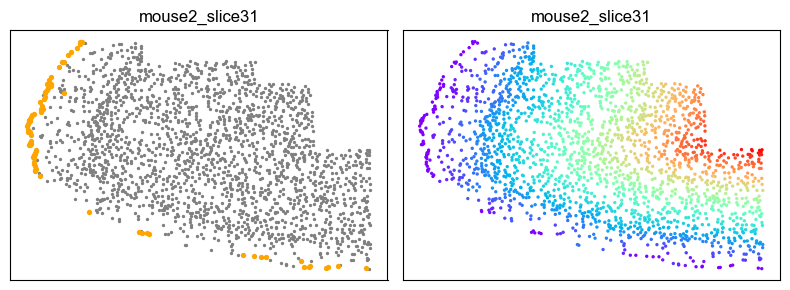

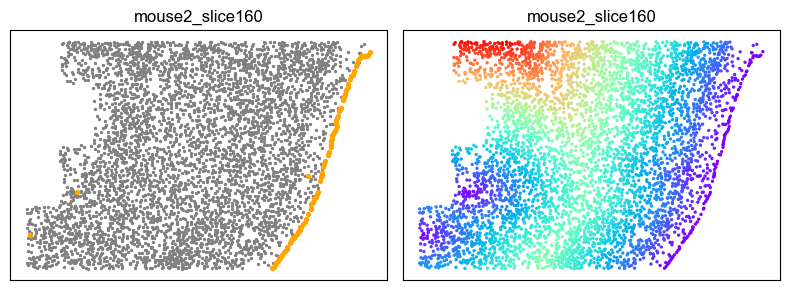

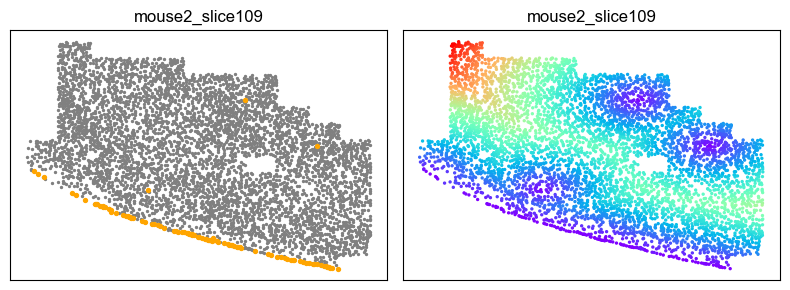

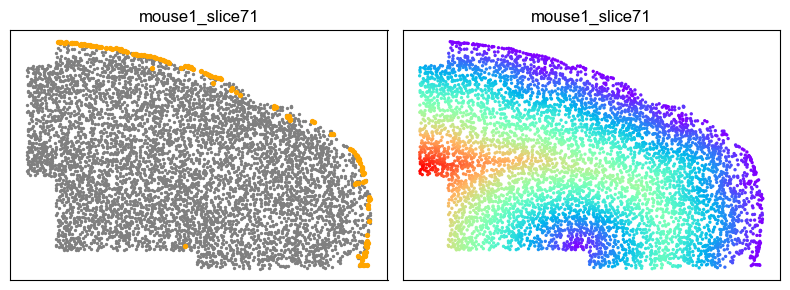

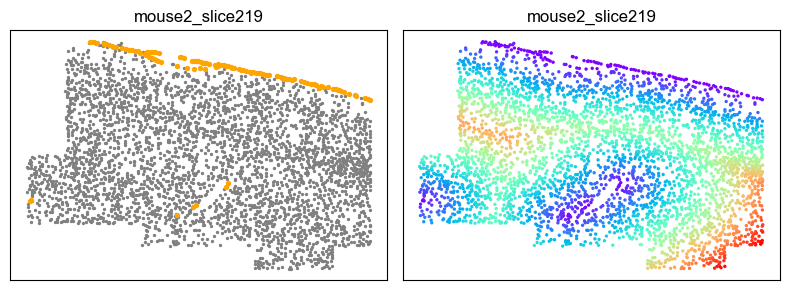

...

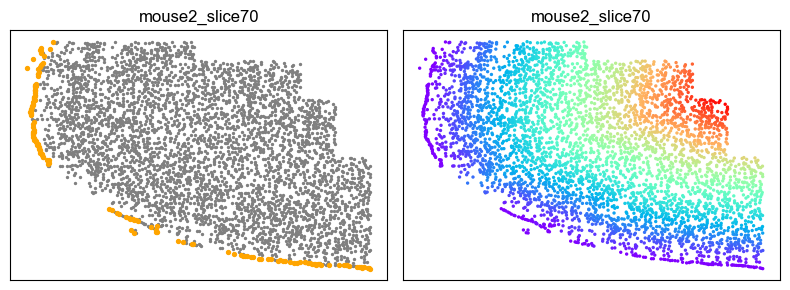

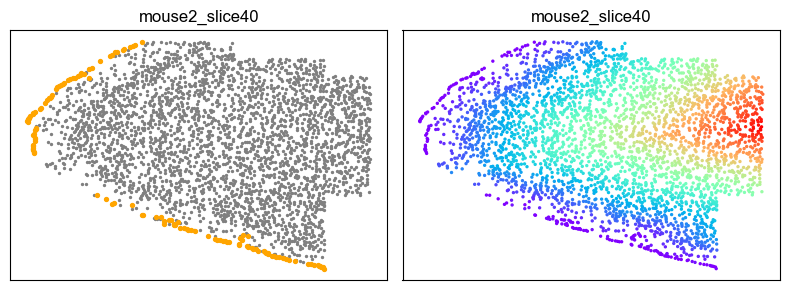

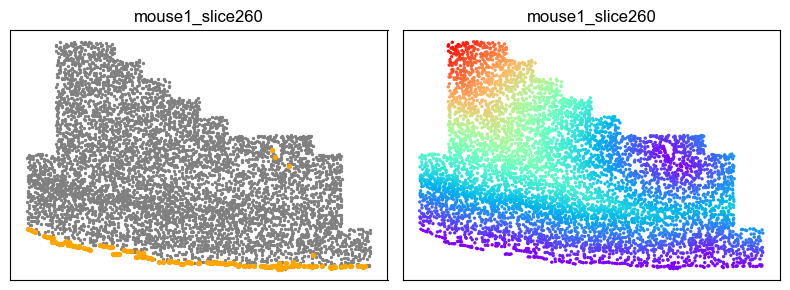

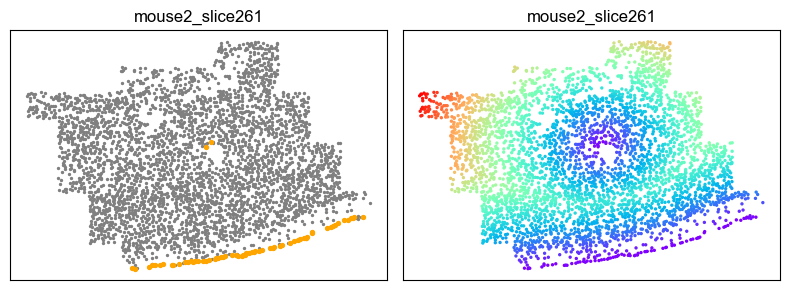

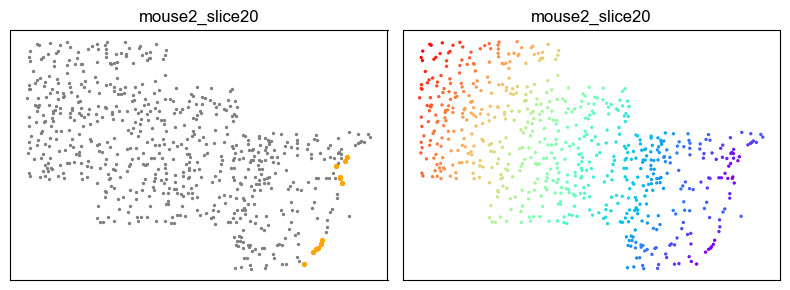

In [31]:
for sample in meta_df['slice_id'].unique():
    sample_df = meta_df[meta_df['slice_id'] == sample]
    fig, axes = plt.subplots(1, 2, figsize=(8, 3))
    
    # VLMC
    ax = axes[0]
    color_list = ['orange' if x == 'VLMC' else 'gray' for x in sample_df['subclass']]
    size_list = [8 if x == 'VLMC' else 2 for x in sample_df['subclass']]
    ax.scatter(sample_df[sample_df['subclass'] != 'VLMC']['x'],
               sample_df[sample_df['subclass'] != 'VLMC']['y'],
               c='gray', s= 2, label='other')
    ax.scatter(sample_df[sample_df['subclass'] == 'VLMC']['x'],
               sample_df[sample_df['subclass'] == 'VLMC']['y'],
               c='orange', s= 8, label='VLMC')
    # ax.legend(loc="upper left", bbox_to_anchor=(1,1))
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(sample)
    
    # cortical depth
    ax = axes[1]
    scatter = ax.scatter(sample_df['x'],
                         sample_df['y'],
                         c=sample_df['cortical_depth'],
                         cmap='rainbow',
                         s=2,
                         edgecolor=None)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(sample)

    fig.tight_layout()
    fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_with_old_cortical_depth.pdf',
                transparent=True)


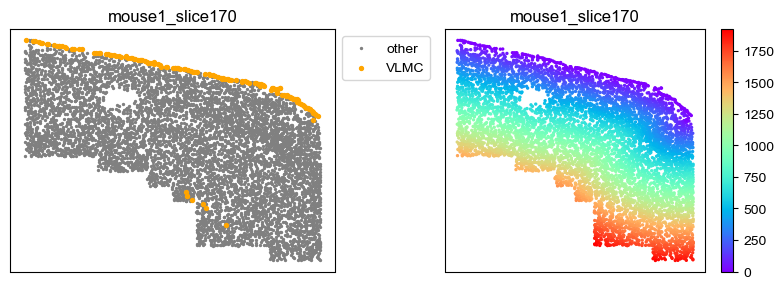

In [103]:
sample = 'mouse1_slice170'

sample_df = meta_df[meta_df['slice_id'] == sample]
fig, axes = plt.subplots(1, 2, figsize=(8, 3))

# VLMC
ax = axes[0]
color_list = ['orange' if x == 'VLMC' else 'gray' for x in sample_df['subclass']]
size_list = [8 if x == 'VLMC' else 2 for x in sample_df['subclass']]
ax.scatter(sample_df[sample_df['subclass'] != 'VLMC']['x'],
           sample_df[sample_df['subclass'] != 'VLMC']['y'],
           c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['subclass'] == 'VLMC']['x'],
           sample_df[sample_df['subclass'] == 'VLMC']['y'],
           c='orange', s= 8, label='VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)

# cortical depth
ax = axes[1]
scatter = ax.scatter(sample_df['x'],
                     sample_df['y'],
                     c=sample_df['cortical_depth'],
                     cmap='rainbow',
                     s=2,
                     edgecolor=None)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
plt.colorbar(scatter)

fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_VLMC_with_old_cortical_depth_legend.pdf', transparent=True)

## corrected cortical dpeth

In [34]:
cortical_depth_df = pd.DataFrame()

### mouse1_slice1

/tmp/ipykernel_3543277/2859424406.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2859424406.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


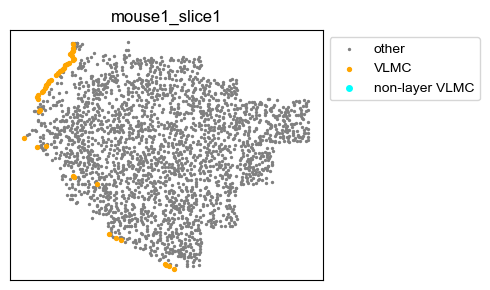

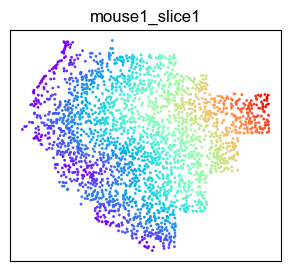

In [35]:
# setting
threshold = 10000000
sample = 'mouse1_slice1'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'


# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)

### mouse1_slice10

/tmp/ipykernel_3543277/4218654194.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/4218654194.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


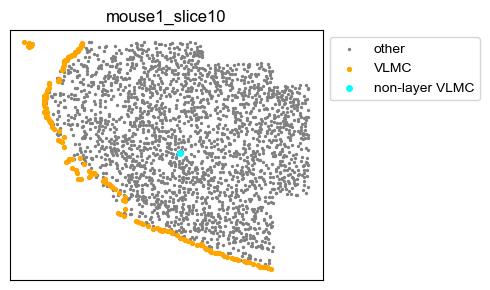

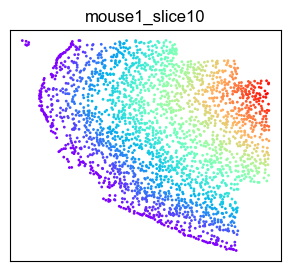

In [36]:
# setting
threshold = 200
sample = 'mouse1_slice10'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)

### mouse1_slice102

/tmp/ipykernel_3543277/2906155823.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2906155823.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


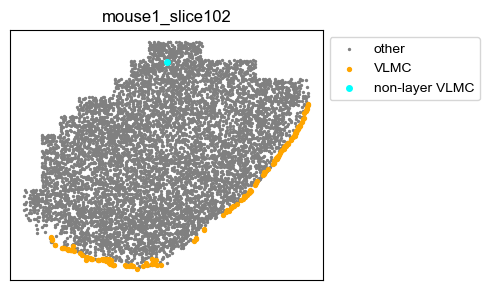

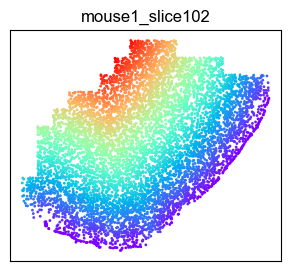

In [37]:
# setting
threshold = 200
sample = 'mouse1_slice102'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)

### mouse1_slice112

/tmp/ipykernel_3543277/1251551310.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1251551310.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


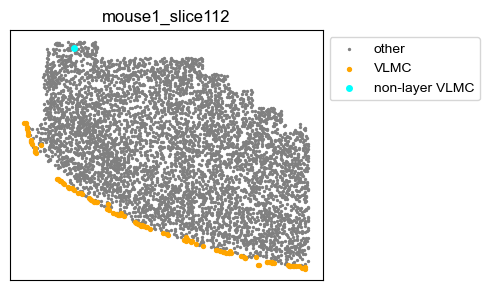

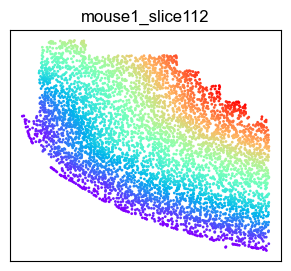

In [38]:
# setting
threshold = 200
sample = 'mouse1_slice112'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)

### mouse1_slice122

/tmp/ipykernel_3543277/1434947842.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1434947842.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


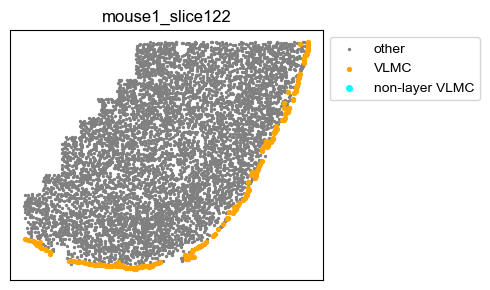

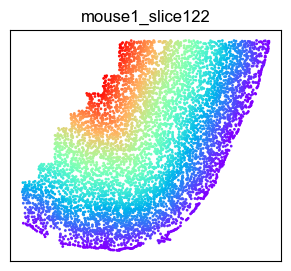

In [39]:
# setting
threshold = 200
sample = 'mouse1_slice122'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice131

/tmp/ipykernel_3543277/3729365932.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3729365932.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


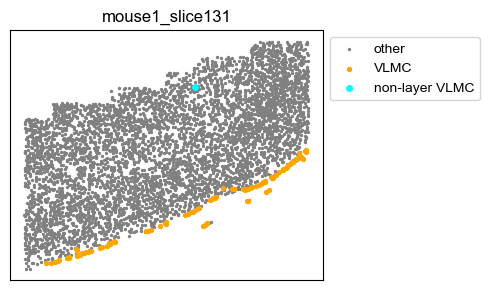

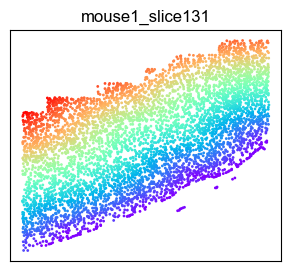

In [40]:
# setting
threshold = 200
sample = 'mouse1_slice131'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice153

/tmp/ipykernel_3543277/3502794037.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3502794037.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


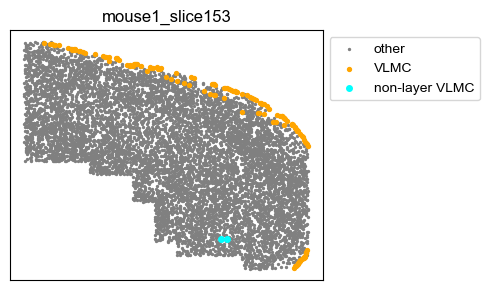

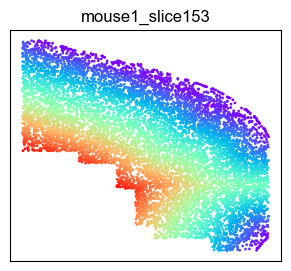

In [41]:
# setting
threshold = 200
sample = 'mouse1_slice153'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice162

/tmp/ipykernel_3543277/2986846804.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2986846804.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


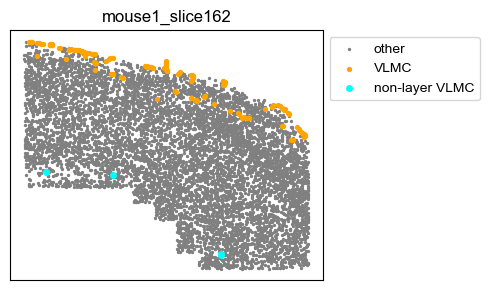

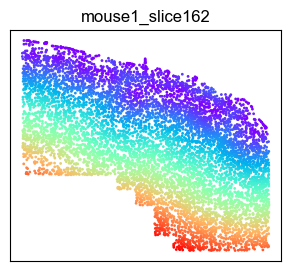

In [42]:
# setting
threshold = 200
sample = 'mouse1_slice162'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice170

/tmp/ipykernel_3543277/1320181977.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1320181977.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


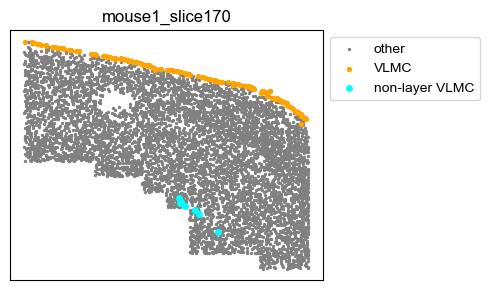

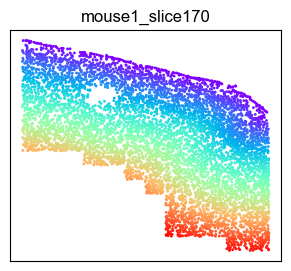

In [43]:
# setting
threshold = 200
sample = 'mouse1_slice170'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,6].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice180

/tmp/ipykernel_3543277/2134111757.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2134111757.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


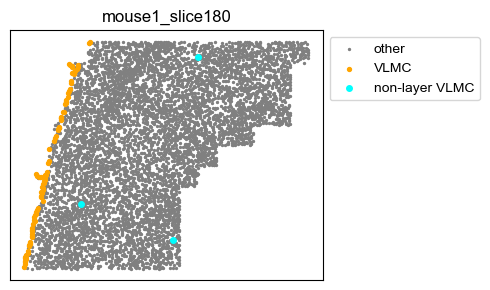

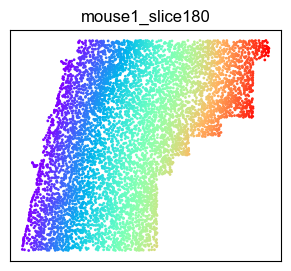

In [44]:
# setting
threshold = 200
sample = 'mouse1_slice180'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice190

/tmp/ipykernel_3543277/962063297.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/962063297.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


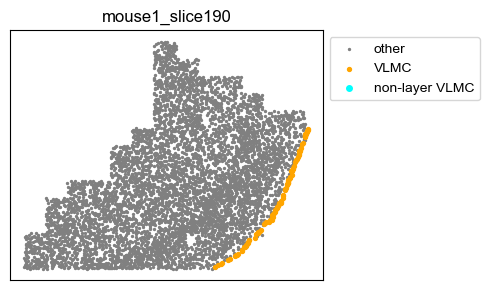

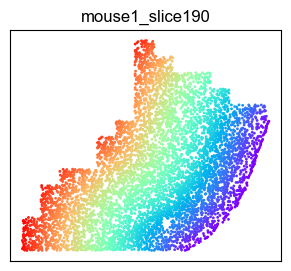

In [45]:
# setting
threshold = 200
sample = 'mouse1_slice190'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice200

/tmp/ipykernel_3543277/890295764.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/890295764.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


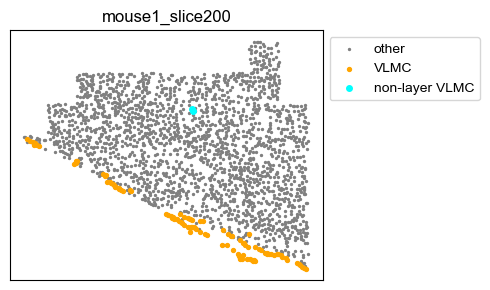

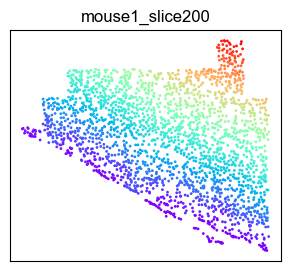

In [46]:
# setting
threshold = 100
sample = 'mouse1_slice200'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice201

/tmp/ipykernel_3543277/2213026809.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2213026809.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


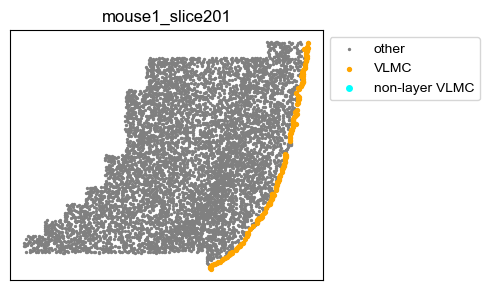

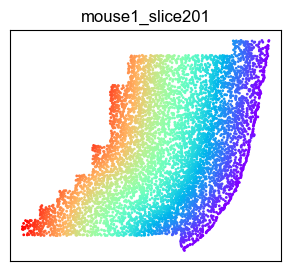

In [47]:
# setting
threshold = 200
sample = 'mouse1_slice201'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice21

/tmp/ipykernel_3543277/2691679232.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2691679232.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


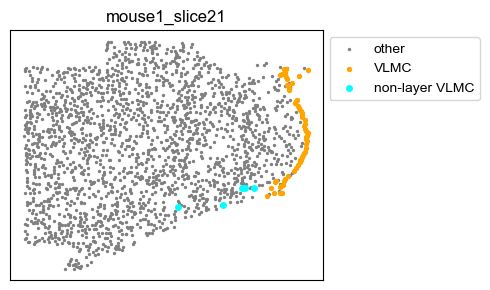

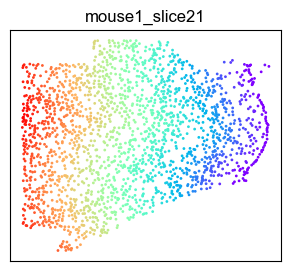

In [48]:
# setting
threshold = 200
sample = 'mouse1_slice21'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,12].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
# filter_label = min_values>threshold

filter_label = sample_VLMC_df['x'] < -4250
sample_df.loc[sample_VLMC_df[filter_label].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice212

/tmp/ipykernel_3543277/1988504448.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1988504448.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


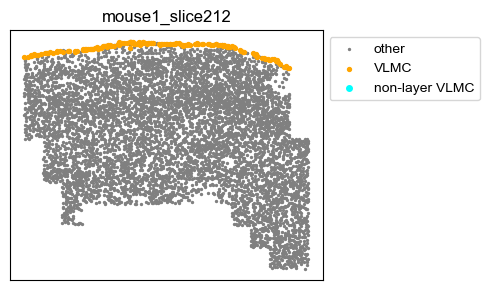

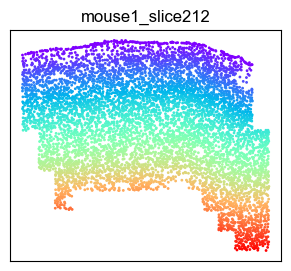

In [49]:
# setting
threshold = 200
sample = 'mouse1_slice212'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice221

/tmp/ipykernel_3543277/2919934848.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2919934848.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


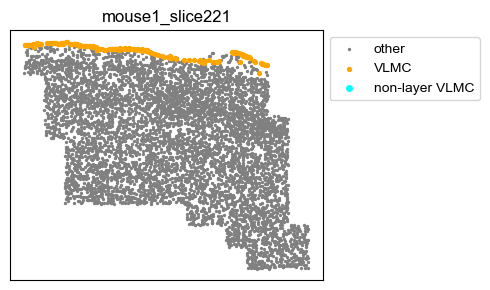

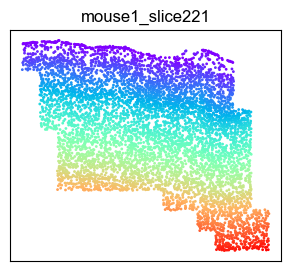

In [50]:
# setting
threshold = 200
sample = 'mouse1_slice221'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice232

/tmp/ipykernel_3543277/3309323269.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3309323269.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


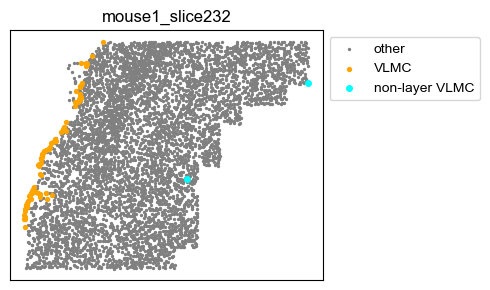

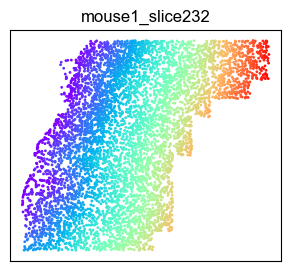

In [51]:
# setting
threshold = 200
sample = 'mouse1_slice232'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice241

/tmp/ipykernel_3543277/2922589259.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2922589259.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


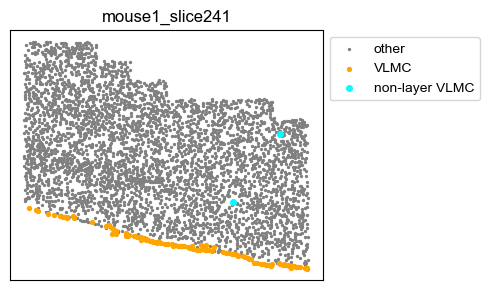

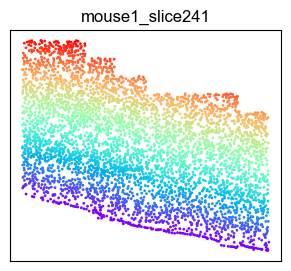

In [52]:
# setting
threshold = 200
sample = 'mouse1_slice241'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice251

/tmp/ipykernel_3543277/3592797966.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3592797966.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


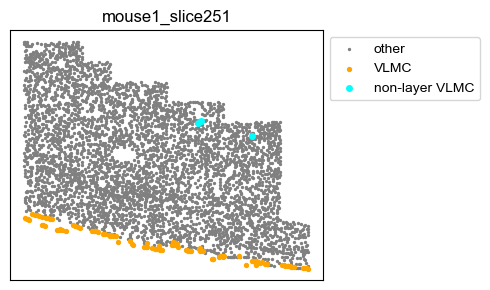

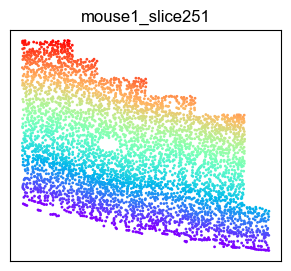

In [53]:
# setting
threshold = 200
sample = 'mouse1_slice251'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice260

/tmp/ipykernel_3543277/2731412224.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2731412224.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


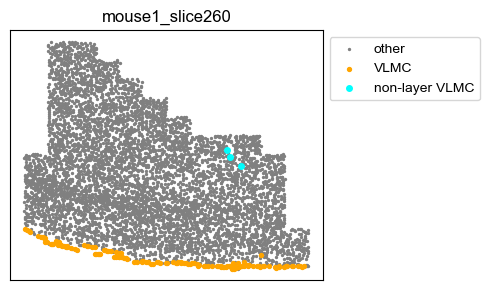

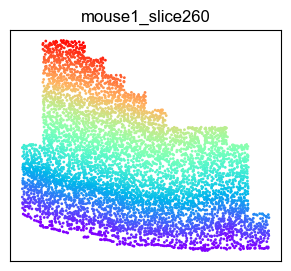

In [54]:
# setting
threshold = 200
sample = 'mouse1_slice260'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,3].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice271

/tmp/ipykernel_3543277/1293424313.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1293424313.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


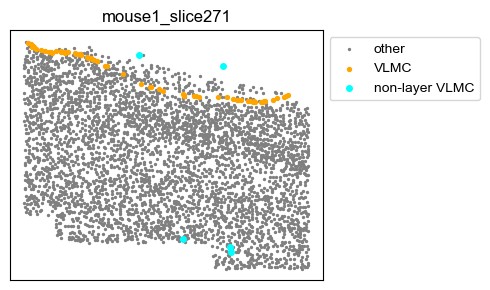

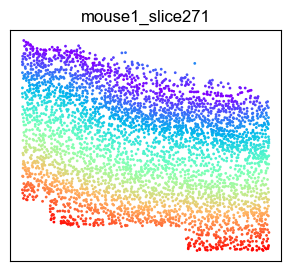

In [55]:
# setting
threshold = 200
sample = 'mouse1_slice271'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice283

/tmp/ipykernel_3543277/3858011691.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3858011691.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


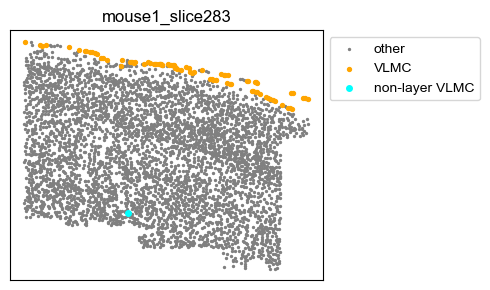

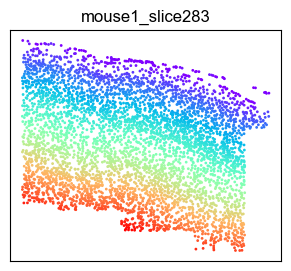

In [56]:
# setting
threshold = 200
sample = 'mouse1_slice283'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice291

/tmp/ipykernel_3543277/1828001595.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1828001595.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


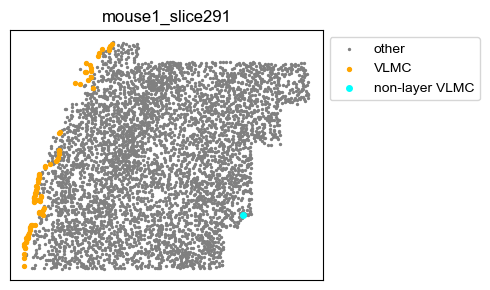

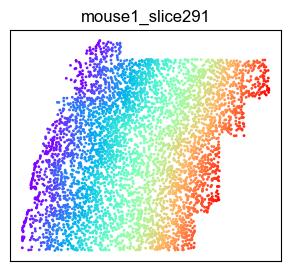

In [57]:
# setting
threshold = 200
sample = 'mouse1_slice291'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice301

/tmp/ipykernel_3543277/3641015250.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3641015250.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


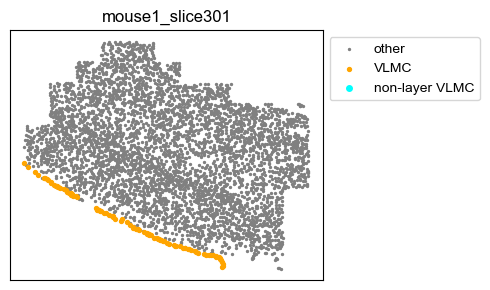

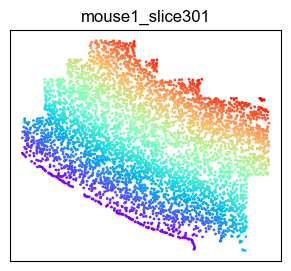

In [58]:
# setting
threshold = 200
sample = 'mouse1_slice301'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice31

/tmp/ipykernel_3543277/1229689488.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1229689488.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


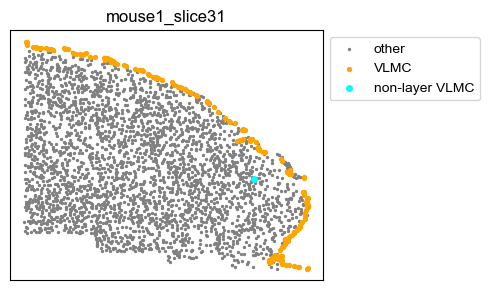

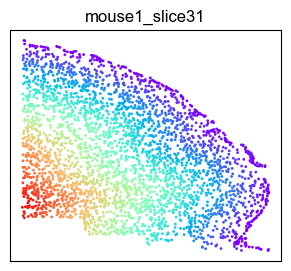

In [59]:
# setting
threshold = 200
sample = 'mouse1_slice31'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice313

/tmp/ipykernel_3543277/1796137712.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1796137712.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


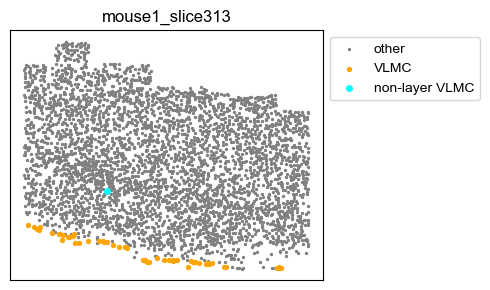

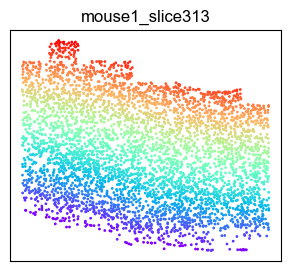

In [60]:
# setting
threshold = 200
sample = 'mouse1_slice313'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice326

/tmp/ipykernel_3543277/2803467290.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2803467290.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


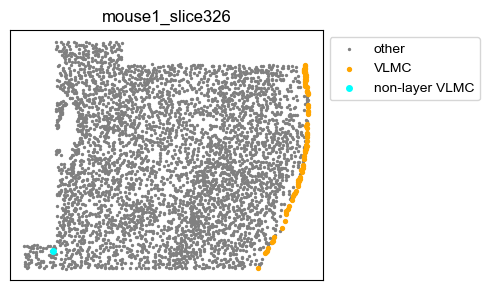

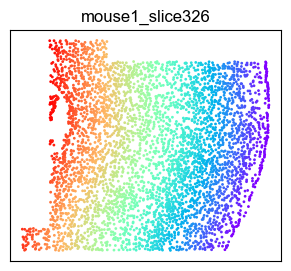

In [61]:
# setting
threshold = 200
sample = 'mouse1_slice326'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice40

/tmp/ipykernel_3543277/3092477158.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3092477158.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


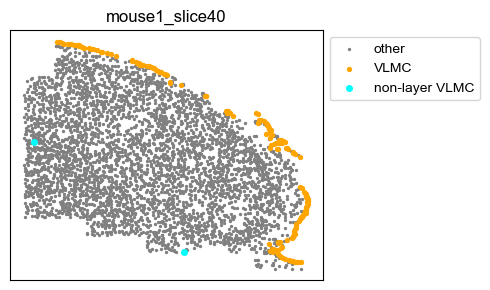

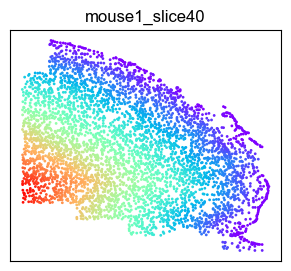

In [62]:
# setting
threshold = 200
sample = 'mouse1_slice40'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice50

/tmp/ipykernel_3543277/1595441829.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1595441829.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


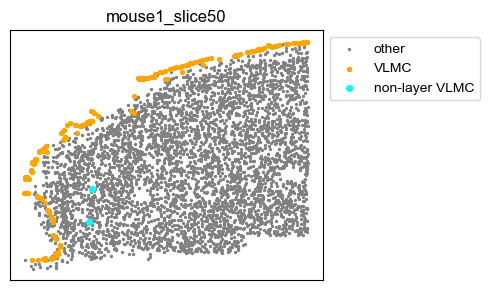

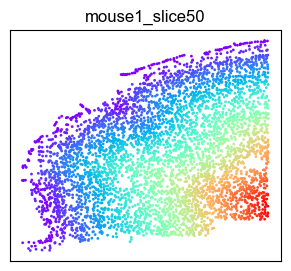

In [63]:
# setting
threshold = 200
sample = 'mouse1_slice50'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice62

/tmp/ipykernel_3543277/1558833872.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1558833872.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


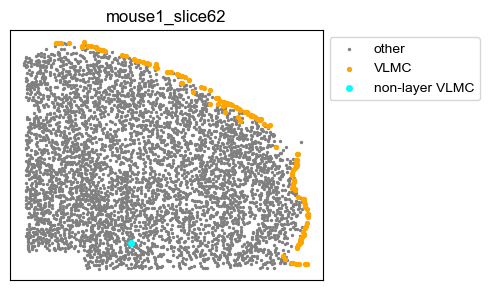

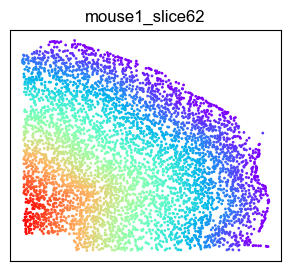

In [64]:
# setting
threshold = 200
sample = 'mouse1_slice62'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice71

/tmp/ipykernel_3543277/3426441697.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3426441697.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


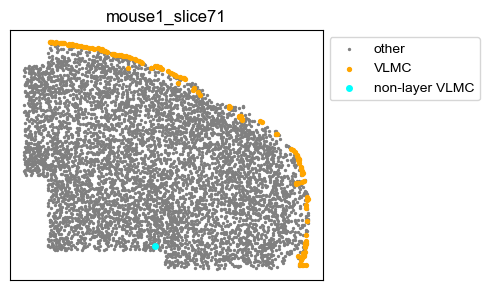

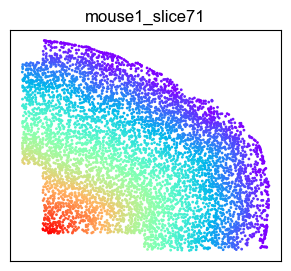

In [65]:
# setting
threshold = 200
sample = 'mouse1_slice71'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice81

/tmp/ipykernel_3543277/1816742149.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1816742149.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


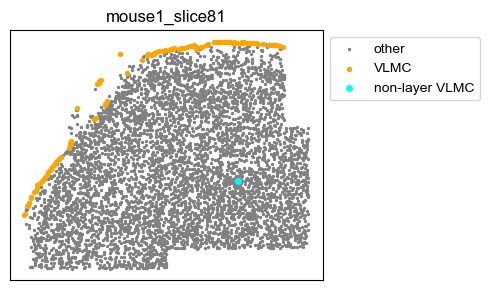

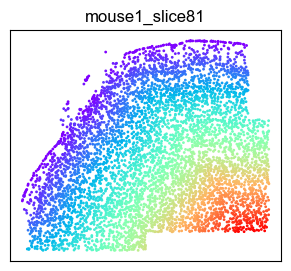

In [66]:
# setting
threshold = 200
sample = 'mouse1_slice81'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse1_slice91

/tmp/ipykernel_3543277/3867841453.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3867841453.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


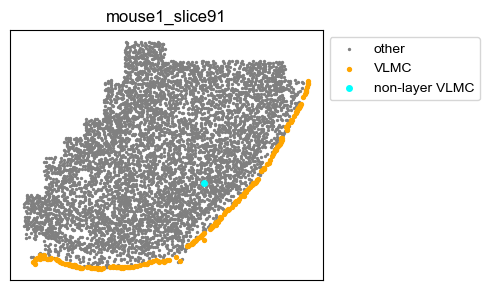

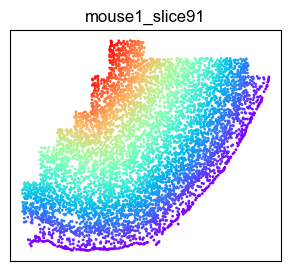

In [67]:
# setting
threshold = 200
sample = 'mouse1_slice91'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)



### mouse2_slice1

/tmp/ipykernel_3543277/3218810823.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3218810823.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


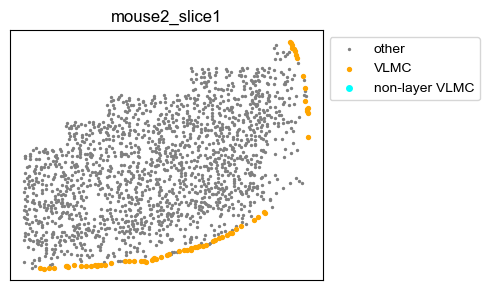

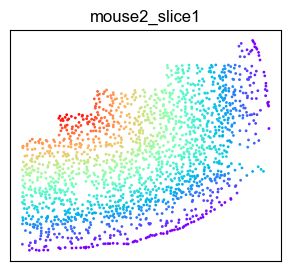

In [68]:
# setting
threshold = 200
sample = 'mouse2_slice1'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice10

/tmp/ipykernel_3543277/1047846944.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1047846944.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


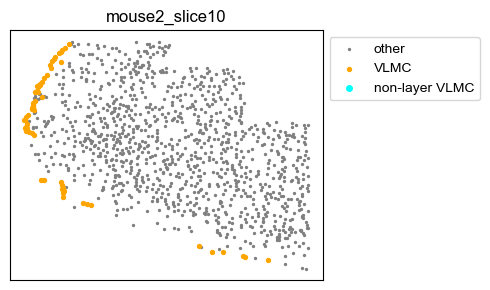

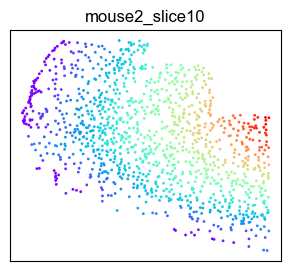

In [69]:
# setting
threshold = 200
sample = 'mouse2_slice10'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice109

/tmp/ipykernel_3543277/1736202761.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1736202761.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


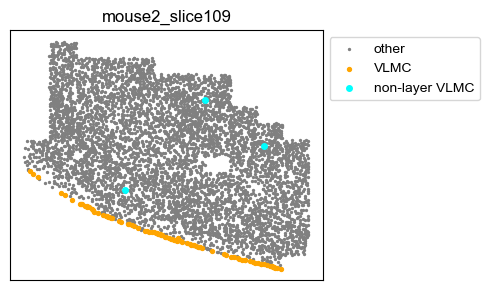

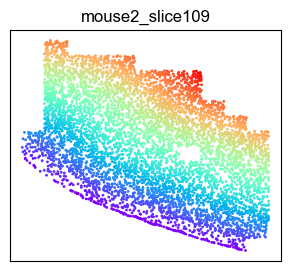

In [70]:
# setting
threshold = 200
sample = 'mouse2_slice109'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice119

/tmp/ipykernel_3543277/1161148399.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1161148399.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


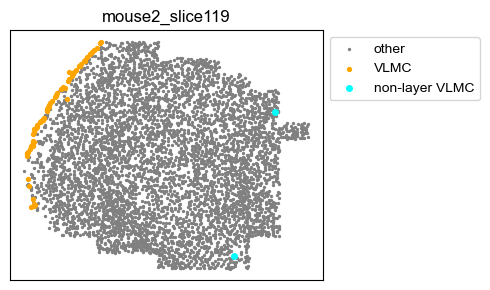

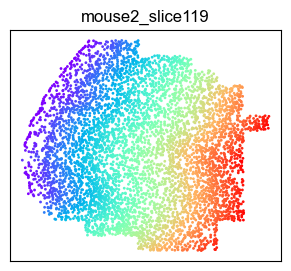

In [71]:
# setting
threshold = 200
sample = 'mouse2_slice119'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice129

/tmp/ipykernel_3543277/3314572802.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3314572802.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


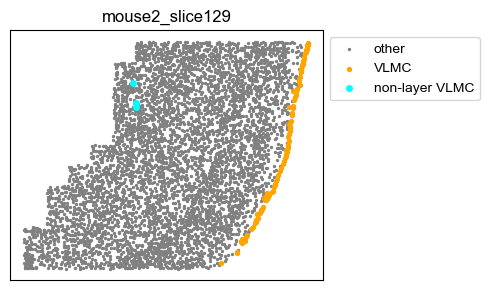

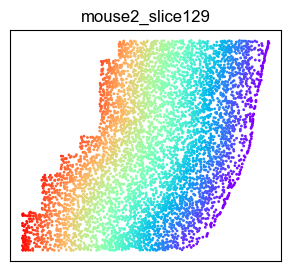

In [72]:
# setting
threshold = 400
sample = 'mouse2_slice129'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,3].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice139

/tmp/ipykernel_3543277/1401830298.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1401830298.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


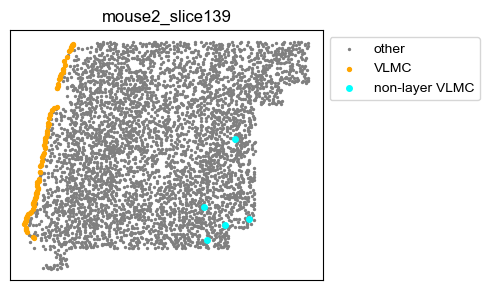

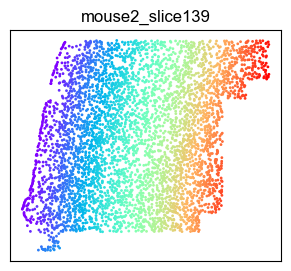

In [73]:
# setting
threshold = 100
sample = 'mouse2_slice139'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice151

/tmp/ipykernel_3543277/3713036500.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3713036500.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


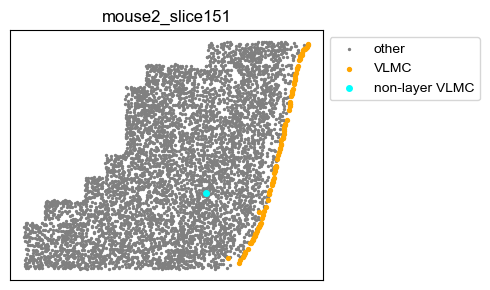

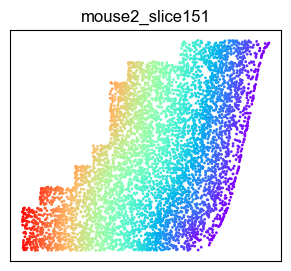

In [74]:
# setting
threshold = 200
sample = 'mouse2_slice151'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice160

/tmp/ipykernel_3543277/1386290675.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1386290675.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


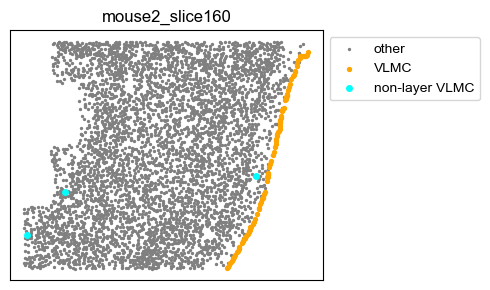

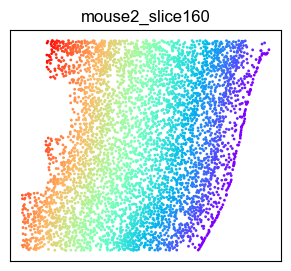

In [75]:
# setting
threshold = 50
sample = 'mouse2_slice160'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice169

/tmp/ipykernel_3543277/693538679.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/693538679.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


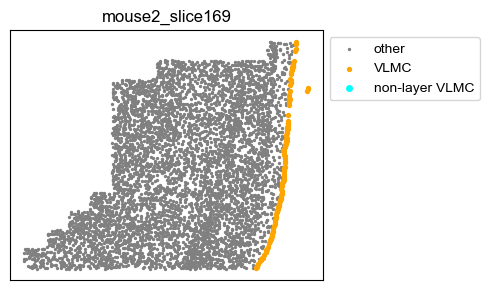

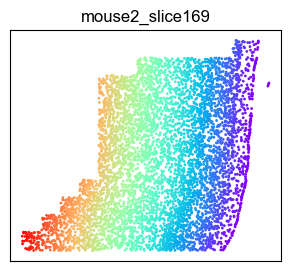

In [76]:
# setting
threshold = 200
sample = 'mouse2_slice169'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice189

/tmp/ipykernel_3543277/2223394806.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2223394806.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


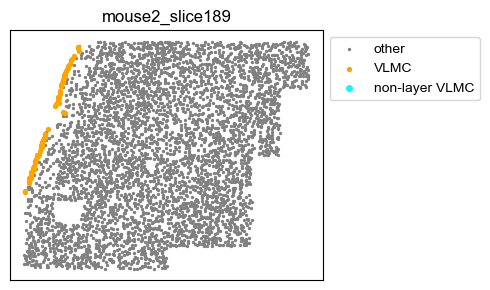

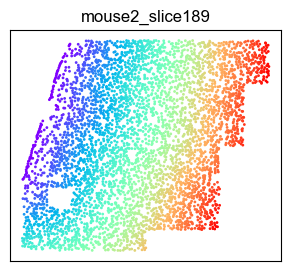

In [77]:
# setting
threshold = 200
sample = 'mouse2_slice189'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice20

/tmp/ipykernel_3543277/937118914.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/937118914.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


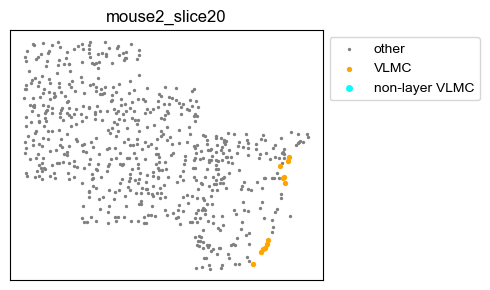

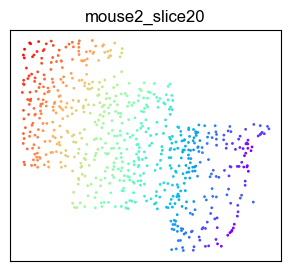

In [78]:
# setting
threshold = 200
sample = 'mouse2_slice20'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice201

/tmp/ipykernel_3543277/3936954082.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3936954082.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


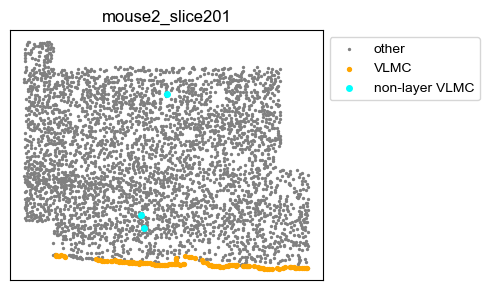

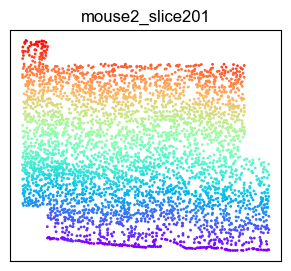

In [79]:
# setting
threshold = 100
sample = 'mouse2_slice201'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice209

/tmp/ipykernel_3543277/4133816148.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/4133816148.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


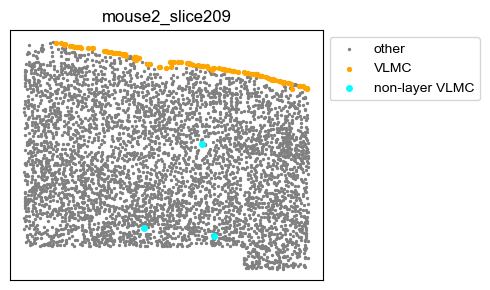

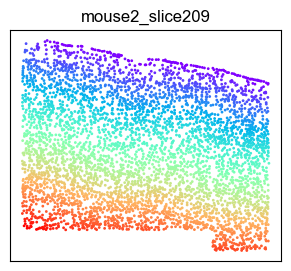

In [80]:
# setting
threshold = 200
sample = 'mouse2_slice209'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice219

/tmp/ipykernel_3543277/332355909.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/332355909.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


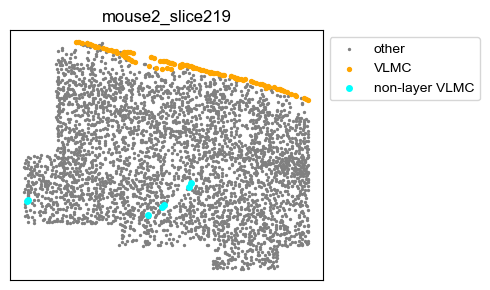

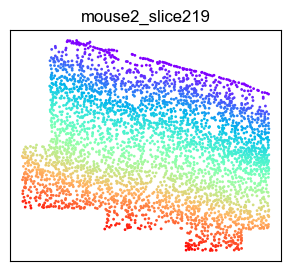

In [81]:
# setting
threshold = 200
sample = 'mouse2_slice219'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,2].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice229

/tmp/ipykernel_3543277/1199232266.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1199232266.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


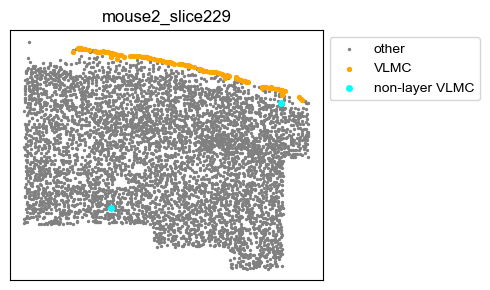

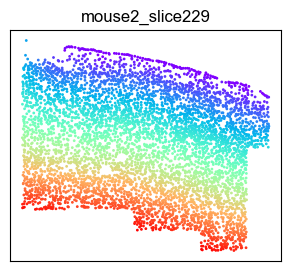

In [82]:
# setting
threshold = 60
sample = 'mouse2_slice229'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice249

/tmp/ipykernel_3543277/2808431205.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2808431205.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


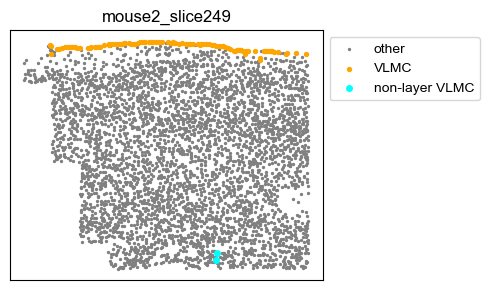

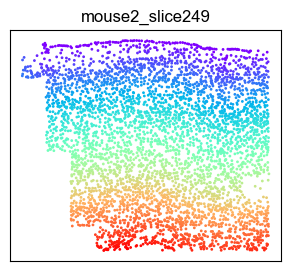

In [83]:
# setting
threshold = 200
sample = 'mouse2_slice249'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice261

/tmp/ipykernel_3543277/900110455.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/900110455.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


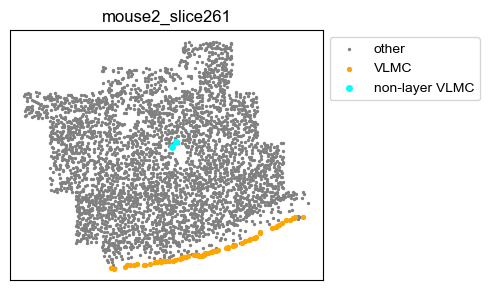

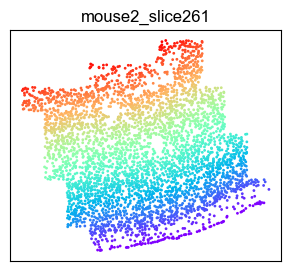

In [84]:
# setting
threshold = 200
sample = 'mouse2_slice261'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice270

/tmp/ipykernel_3543277/2111406195.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2111406195.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


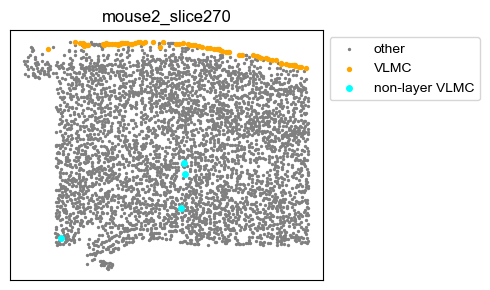

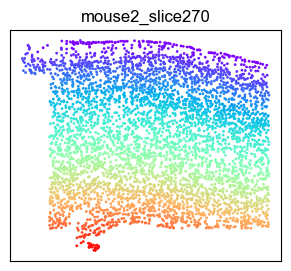

In [85]:
# setting
threshold = 400
sample = 'mouse2_slice270'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,2].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice280

/tmp/ipykernel_3543277/433833021.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/433833021.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


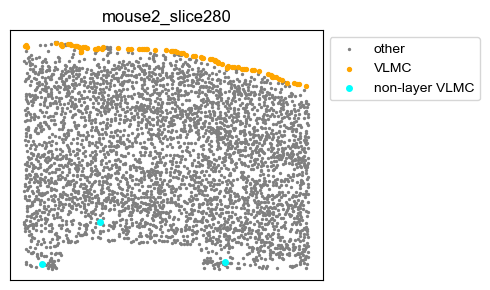

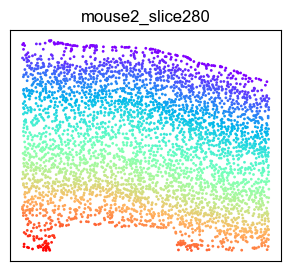

In [86]:
# setting
threshold = 200
sample = 'mouse2_slice280'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice289

/tmp/ipykernel_3543277/1340205479.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1340205479.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


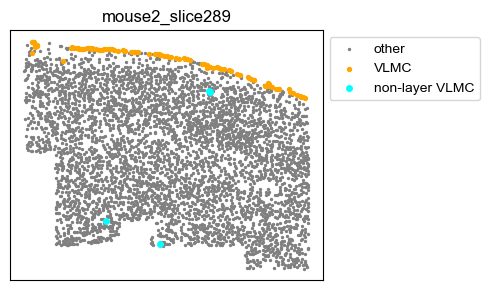

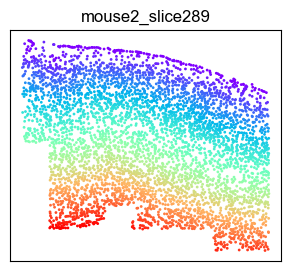

In [87]:
# setting
threshold = 200
sample = 'mouse2_slice289'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = masked_VLMC_distance_matrix[np.arange(masked_VLMC_distance_matrix.shape[0]),
np.apply_along_axis(np.argsort, 1, masked_VLMC_distance_matrix)[:,1].reshape(-1)]
# min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice300

/tmp/ipykernel_3543277/835520055.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/835520055.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


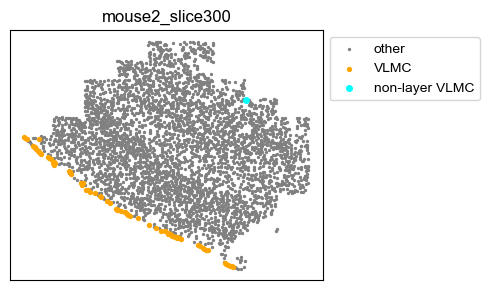

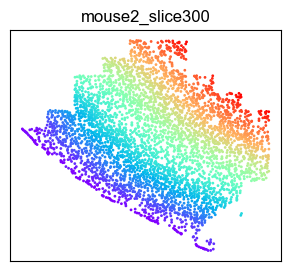

In [88]:
# setting
threshold = 200
sample = 'mouse2_slice300'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice309

/tmp/ipykernel_3543277/3241302298.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3241302298.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


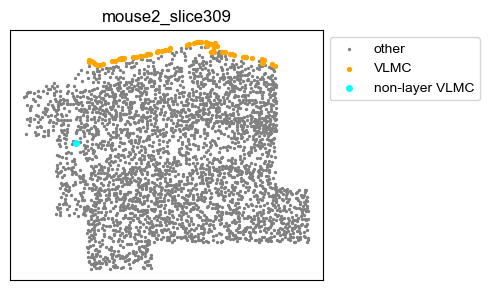

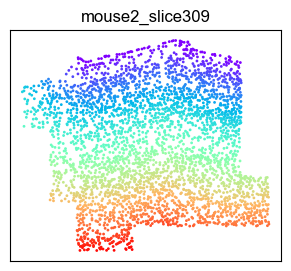

In [89]:
# setting
threshold = 200
sample = 'mouse2_slice309'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice31

/tmp/ipykernel_3543277/1926802234.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1926802234.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


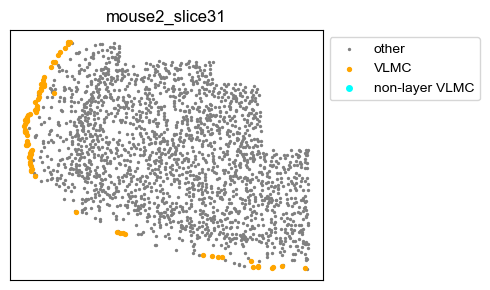

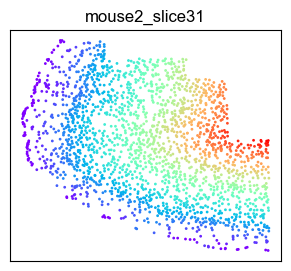

In [90]:
# setting
threshold = 500
sample = 'mouse2_slice31'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice319

/tmp/ipykernel_3543277/3727334983.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3727334983.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


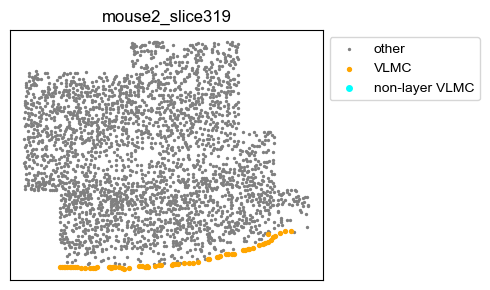

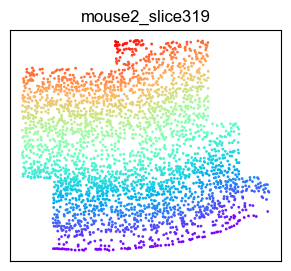

In [91]:
# setting
threshold = 200
sample = 'mouse2_slice319'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice40

/tmp/ipykernel_3543277/2987883859.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2987883859.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


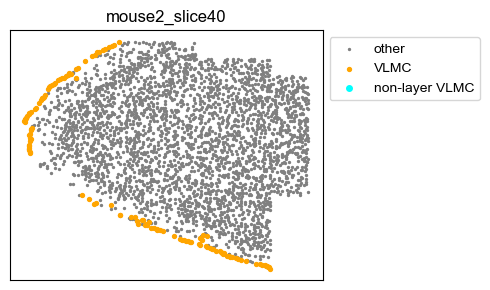

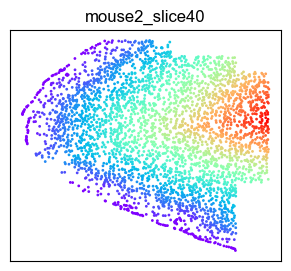

In [92]:
# setting
threshold = 200
sample = 'mouse2_slice40'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice50

/tmp/ipykernel_3543277/3479130814.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/3479130814.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


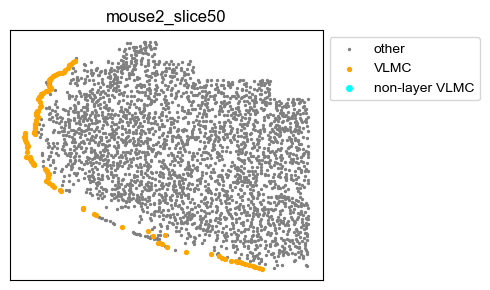

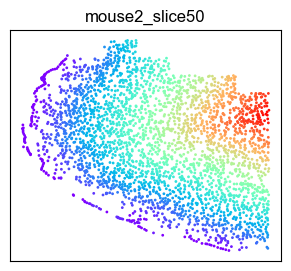

In [93]:
# setting
threshold = 200
sample = 'mouse2_slice50'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice61

/tmp/ipykernel_3543277/4213026973.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/4213026973.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


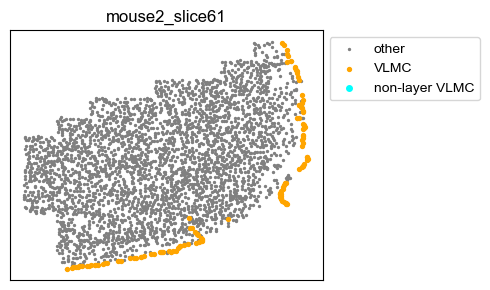

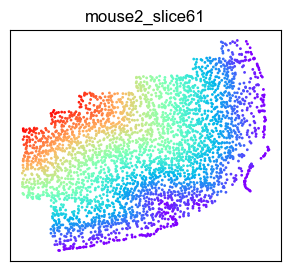

In [94]:
# setting
threshold = 1000
sample = 'mouse2_slice61'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice70

/tmp/ipykernel_3543277/2640541311.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/2640541311.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


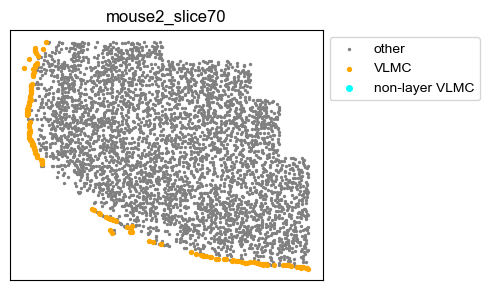

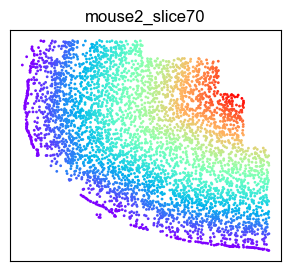

In [95]:
# setting
threshold = 200
sample = 'mouse2_slice70'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice79

/tmp/ipykernel_3543277/420537115.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/420537115.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


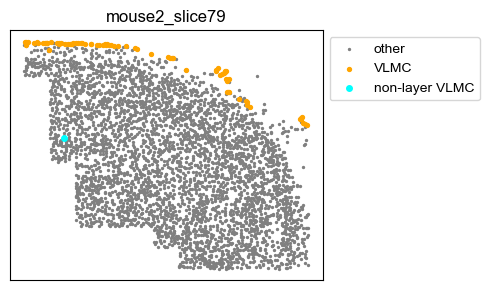

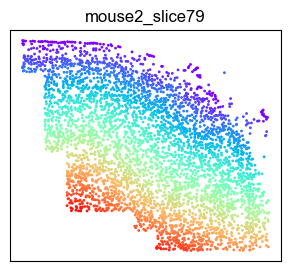

In [96]:
# setting
threshold = 200
sample = 'mouse2_slice79'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice90

/tmp/ipykernel_3543277/1381142540.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/1381142540.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


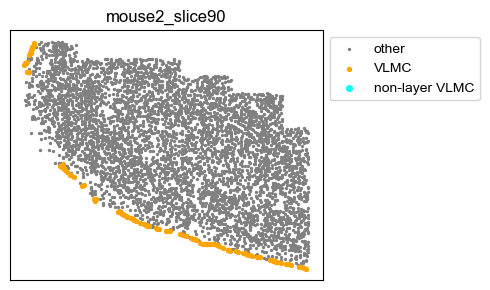

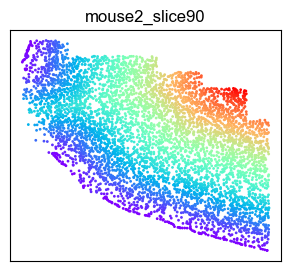

In [97]:
# setting
threshold = 200
sample = 'mouse2_slice90'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


### mouse2_slice99

/tmp/ipykernel_3543277/169028682.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['extra_annot'] = sample_df['subclass']
/tmp/ipykernel_3543277/169028682.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)


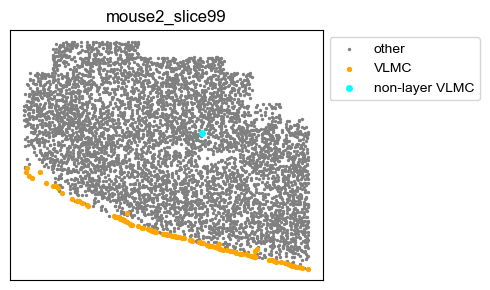

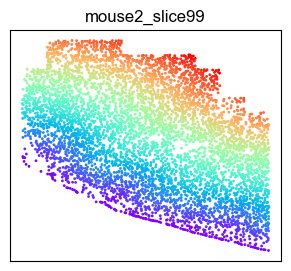

In [98]:
# setting
threshold = 200
sample = 'mouse2_slice99'

# VLMC distance matrix
sample_df = cell_label_df[cell_label_df['slice_id'] == sample]
sample_VLMC_df = sample_df[sample_df['subclass'] == 'VLMC']
distance_matrix = distance.cdist(sample_df[['x','y']].values, sample_df[['x','y']].values, 'euclidean')
VLMC_distance_matrix = distance_matrix[:,sample_df['subclass'] == 'VLMC'][sample_df['subclass'] == 'VLMC',:]

# filter VLMC
masked_VLMC_distance_matrix = VLMC_distance_matrix + np.eye(VLMC_distance_matrix.shape[0]) * np.max(VLMC_distance_matrix)
min_values = np.min(masked_VLMC_distance_matrix, axis=1)
sample_df['extra_annot'] = sample_df['subclass']
sample_df.loc[sample_VLMC_df[min_values>threshold].index,'extra_annot'] = 'non-layer VLMC'

# visualization
fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(sample_df[sample_df['subclass']!='VLMC']['x'], sample_df[sample_df['subclass']!='VLMC']['y'], c='gray', s= 2, label='other')
ax.scatter(sample_df[sample_df['extra_annot']=='VLMC']['x'], sample_df[sample_df['extra_annot']=='VLMC']['y'], c='orange', s= 8, label='VLMC')
ax.scatter(sample_df[sample_df['extra_annot']=='non-layer VLMC']['x'], sample_df[sample_df['extra_annot']=='non-layer VLMC']['y'], c='cyan', s= 16, label='non-layer VLMC')
ax.legend(loc="upper left", bbox_to_anchor=(1,1))
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.tight_layout()
fig.savefig(f'{output_fig_dir}/saptial_{sample}_VLMC_2.pdf', transparent=True)

# cortical depth
sample_df['cortical_depth'] = np.min(distance_matrix[:,sample_df['extra_annot'] == 'VLMC'],axis=1)
cortical_depth_df = pd.concat([cortical_depth_df, sample_df[['cortical_depth','extra_annot']]])

# visualization
fig, ax = plt.subplots(figsize=(3.5, 3))
scatter = ax.scatter(sample_df['x'], sample_df['y'], c=sample_df['cortical_depth'], cmap='rainbow', s=1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title(sample)
fig.savefig(f'{output_fig_dir}/saptial_{sample}_cortical_depth.pdf', transparent=True)


In [99]:
cortical_depth_df.head()

,cortical_depth,extra_annot
100023173600007776283900355785793185282,799.877198,Astro
100357557613983092542421396030726393144,178.014196,L2/3 IT
100438314633131300286240527528820911794,415.022169,Pvalb
100689500727523367948135048603789232105,206.692900,Astro
100756095765922513431551474967095417597,758.117286,L6 CT


In [100]:
cortical_depth_df.shape

(280186, 2)

In [101]:
meta_df  = cell_label_df.join(cortical_depth_df)
meta_df.head()

,sample_id,slice_id,class_label,subclass,label,x,y,cortical_depth,extra_annot
10000143038275111136124942858811168393,mouse2_sample4,mouse2_slice31,Other,Astro,Astro_1,4738.402723,3075.604074,888.114748,Astro
100001798412490480358118871918100400402,mouse2_sample5,mouse2_slice160,Other,Endo,Endo,-3965.470904,1451.943297,1449.123485,Endo
100006878605830627922364612565348097824,mouse2_sample6,mouse2_slice109,Other,SMC,SMC,805.848948,1215.458623,22.943763,SMC
100007228202835962319771548915451072492,mouse1_sample2,mouse1_slice71,Other,Endo,Endo,1347.655448,-3589.803355,1086.621925,Endo
100009332472089331948140672873134747603,mouse2_sample5,mouse2_slice219,Glutamatergic,L2/3 IT,L23_IT_3,-3584.216904,-1883.214455,308.178627,L2/3 IT


In [102]:
meta_df.to_csv('cell_label_with_meta.csv.gz', index=True, index_label='Cell_ID')